<a href="https://colab.research.google.com/github/buessow/glumagic/blob/master/modelling/Glucose_Prediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [41]:
#@title Imports
# !pip install -q tfds-nightly

%load_ext google.colab.data_table
# %load_ext tensorboard


import datetime as datetime
import json
import os
# import hashlib
import tensorflow as tf
from tensorflow import keras
# import tensorflow_datasets as tfds
import matplotlib.pyplot as plt
import datetime as datetime
import dateutil.parser
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import matplotlib.lines as lines
from matplotlib.patches import Rectangle
import matplotlib.table as tab
import math
import numpy as np
import pandas as pd
import pytz
import pprint
import statistics
import sys
import unittest
from datetime import datetime
from datetime import time
from datetime import timedelta
from datetime import timezone
from google.colab import data_table
from google.colab import drive
from google.colab import userdata
from tabulate import tabulate

pp = pprint.PrettyPrinter(indent=2)
mpl.style.use('dark_background')
data_table._DEFAULT_FORMATTERS[float] = lambda x: f'{x:.2f}'
data_table._DEFAULT_FORMATTERS[np.float32] = lambda x: f'{x:.2f}'

CACHE_DIR = '/content/drive/My Drive/Glucose Prediction Work'

The google.colab.data_table extension is already loaded. To reload it, use:
  %reload_ext google.colab.data_table


In [42]:
pp.pprint('TensorFlow version: {}'.format(tf.__version__))

'TensorFlow version: 2.15.0'


In [43]:
START = '2021-10-01'
END = '2023-01-01'

In [44]:
!apt-get install openjdk-17-jre-headless -qq > /dev/null
os.environ["JAVA_HOME"] = "/usr/lib/jvm/java-17-openjdk-amd64"
!update-alternatives --set java /usr/lib/jvm/java-17-openjdk-amd64/bin/java
!java -version

openjdk version "17.0.9" 2023-10-17
OpenJDK Runtime Environment (build 17.0.9+9-Ubuntu-122.04)
OpenJDK 64-Bit Server VM (build 17.0.9+9-Ubuntu-122.04, mixed mode, sharing)


In [45]:
API_KEY = userdata.get('mongoApiKey')
!java -jar "$CACHE_DIR"/glumagic-1.0.jar api -from {START} -to {END} -db heroku_wxt9ng46 -k {API_KEY} -o input.csv


Loaded 131616 values


In [46]:
glucose = pd.read_csv('input.csv')
glucose.date = pd.to_datetime(glucose.date)
glucose.set_index('date', inplace=True)
glucose.rename({
    'glucoseSlope1': 'gl_slope',
    'glucoseSlope2': 'gl_slop2',
    'hrLong1': 'hr_long',
    'hrLong2': 'hr_lon2',
    'heartRate': 'heart_rate',
    'carbAction': 'ca',
    'insulinAction': 'ia'}, axis=1, errors='raise', inplace=True)

glucose.info()
glucose.head(2000)

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 131616 entries, 2021-10-01 00:00:00+00:00 to 2022-12-31 23:55:00+00:00
Data columns (total 12 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   hour        131616 non-null  int64  
 1   glucose     129916 non-null  float64
 2   gl_slope    129771 non-null  float64
 3   gl_slop2    129626 non-null  float64
 4   heart_rate  100785 non-null  float64
 5   hr_long     131616 non-null  float64
 6   hr_lon2     131616 non-null  float64
 7   carbs       131616 non-null  float64
 8   ca          131616 non-null  float64
 9   bolus       131616 non-null  float64
 10  basal       131616 non-null  float64
 11  ia          131616 non-null  float64
dtypes: float64(11), int64(1)
memory usage: 13.1 MB


,hour,glucose,gl_slope,gl_slop2,heart_rate,hr_long,hr_lon2,carbs,ca,bolus,basal,ia
date,,,,,,,,,,,,
2021-10-01 00:00:00+00:00,2,43.58194,0.000000,0.000000,45.000000,0.0,7.0,0.0,8.219033,0.0,0.053333,0.272790
2021-10-01 00:05:00+00:00,2,42.83612,-0.332776,-0.038361,45.430000,0.0,7.0,0.0,7.447785,0.0,0.053333,0.241433
2021-10-01 00:10:00+00:00,2,40.25418,-0.383612,0.020736,46.428570,0.0,7.0,0.0,6.637708,0.0,0.053333,0.213812
2021-10-01 00:15:00+00:00,2,39.00000,-0.125418,0.038361,46.143814,0.0,7.0,0.0,5.841579,0.0,0.053333,0.190181
2021-10-01 00:20:00+00:00,2,39.00000,0.000000,0.012542,44.140000,0.0,7.0,0.0,5.091713,0.0,0.053333,0.171972
...,...,...,...,...,...,...,...,...,...,...,...,...
2021-10-07 22:15:00+00:00,0,247.84000,-1.008188,0.054142,56.000000,1.0,7.0,0.0,0.000000,0.0,0.014389,4.466788
2021-10-07 22:20:00+00:00,0,243.51678,-0.800000,0.022382,59.570000,1.0,7.0,0.0,0.000000,0.0,0.019374,4.031352
2021-10-07 22:25:00+00:00,0,239.84000,-0.784370,-0.047263,62.612040,1.0,7.0,0.0,0.000000,0.3,0.095750,3.667719


<Axes: >

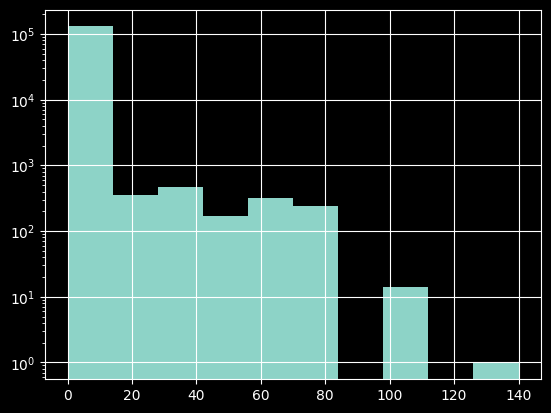

In [47]:
glucose.carbs.hist(log=True)

In [48]:
#@title Import Library from Github
![ -d gmagic ] || git clone https://github.com/buessow/gmagic.git
!cd gmagic; git pull origin
from gmagic.lib import LogNormAction as lna
from gmagic.lib.DateTimeInsulin import DateTimeInsulin, TimeInsulin
from gmagic.lib.Profile import Profile
from gmagic.lib.ProfileSwitch import ProfileSwitch
from gmagic.lib.TempBasal import TempBasal

Already up to date.


# Date Range of the Fetched Data

# Load Data

<Axes: ylabel='Frequency'>

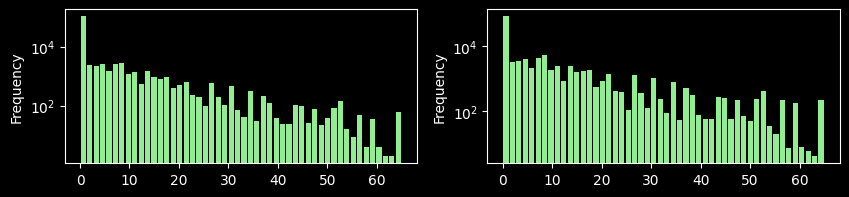

In [49]:
#@title Long Term Heart Rate

HR_HIGH_THRESHOLD = 120
HR_LONG_MINUTES = [24 * 60, 48 * 60]
HR_LONG_COLS = ['hr_long', 'hr_lon2']

_, axs = plt.subplots(nrows=1, ncols=2, subplot_kw={}, figsize=(10,2))
glucose['hr_long'].plot.hist(ax=axs[0], logy=True, bins=50, rwidth=0.8, color='lightgreen')
glucose['hr_lon2'].plot.hist(ax=axs[1], logy=True, bins=50, rwidth=0.8, color='lightgreen')


<Axes: ylabel='Frequency'>

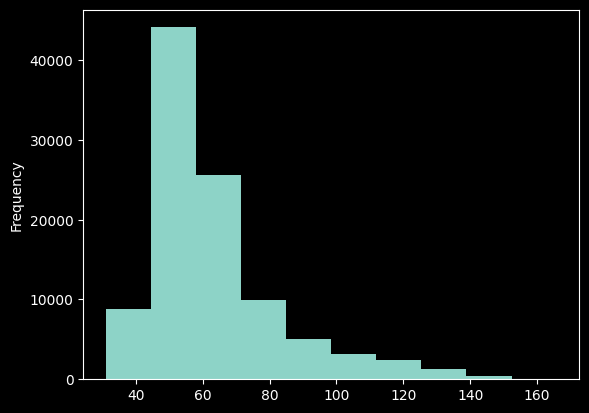

In [50]:
#@title Heart Rate Histogram
glucose.heart_rate.plot.hist()

In [51]:
#@title Bolus and Carbohydrates
# insulin = read_cached_collection(
#     name='treatments',
#     columns=[('created_at', 'date'), 'insulin'],
#     filter={'insulin': {'$ne': None}, 'created_at': {'$gt': START, '$lt': END}},
#     limit=0)
# carbs = read_cached_collection(
#     name='treatments',
#     columns=[('created_at', 'date'), 'carbs'],
#     filter={'carbs': {'$ne': None}, 'created_at': {'$gt': START, '$lt': END}},
#     limit=0)

# insulin.sort_values(by='date', inplace=True)
# carbs.sort_values(by='date', inplace=True)

# Insulin and Carbohydrate Action


mode 1.000000
mode 0.750000


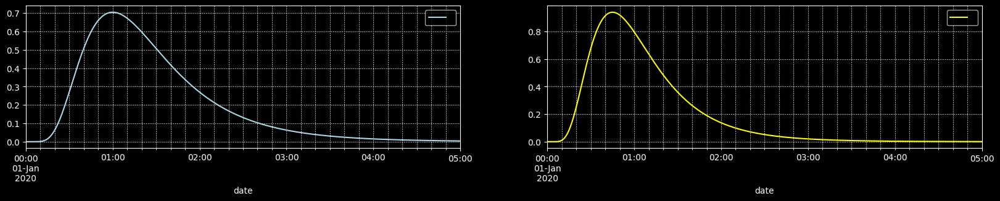

In [52]:
INSULIN_ACTION = lna.LogNormAction(mode=timedelta(minutes=60), sigma=0.5)
CARB_ACTION = lna.LogNormAction(mode=timedelta(minutes=45), sigma=0.50)

fig, axs = plt.subplots(nrows=1, ncols=2, subplot_kw={}, figsize=(20,3))
INSULIN_ACTION.plot(timedelta(hours=5), color='lightblue', ax=axs[0])
CARB_ACTION.plot(timedelta(hours=5), color='yellow', ax=axs[1])

In [53]:
#@title Slope Series

def slope_series(x_series, y_series, x_per=1):
  x_diff = x_series.shift(-1) - x_series.shift(1)
  y_diff = y_series.shift(-1) - y_series.shift(1)
  return x_diff / (y_diff / x_per)

# Pivot Table

Pivot values of 2 hours to one column per 5 minutes. Take glucose after 1:30 and 2 hours as target label and remove other glucose values from second hour.

In [54]:
def value_col_name(n, m):
  if n == 'glucose': n = 'gl'
  elif n == 'gl_slope': n = 'gls'
  elif n == 'gl_slop2': n = 'gls2'
  elif n == 'heart_rate': n = 'hr'
  return '%s_%03d' % (n, m)
def gl_col_name(m): return value_col_name('glucose', m)
def gl_slope_col_name(m): return value_col_name('gl_slope', m)
def ia_col_name(m): return value_col_name('ia', m)
def ca_col_name(m): return value_col_name('ca', m)


In [124]:
PERIOD_STEP = timedelta(minutes=5)
PERIOD_STEP_MIN = PERIOD_STEP // timedelta(minutes=1)
PERIOD_F = timedelta(hours=3)
PERIOD_L = timedelta(hours=1)
PERIOD = PERIOD_F + PERIOD_L
PERIOD_MINUTES = range(0, PERIOD_STEP_MIN * (PERIOD // PERIOD_STEP), PERIOD_STEP_MIN)
PERIOD_F_MINUTES = range(0, PERIOD_STEP_MIN * (PERIOD_F // PERIOD_STEP), PERIOD_STEP_MIN)
PERIOD_L_MINUTES = range(PERIOD_STEP_MIN * (PERIOD_F // PERIOD_STEP),
                         PERIOD_STEP_MIN * (PERIOD // PERIOD_STEP),
                         PERIOD_STEP_MIN)

def label_to_minute(minutes):
  return minutes - (-PERIOD_STEP + PERIOD_F) / timedelta(minutes=1)

g = glucose.copy()
g = g[~g.index.to_series().between(
    datetime(2022, 4, 10, tzinfo=pytz.UTC),
    datetime(2022, 7, 6, tzinfo=pytz.UTC))]

def datetime_to_period(dt):
  day = dt.floor('D')
  t = dt - day
  return day + PERIOD * (t // PERIOD)

values = ['glucose', 'heart_rate', 'gl_slope', 'gl_slop2', 'ia', 'ca']
def pivot_for_model(df):
  df = df.copy()
  df['minute'] = df.index.map(lambda dt: 5 * ((dt - datetime_to_period(dt)) // timedelta(minutes=5)))
  df.index = df.index.map(datetime_to_period)
  df.reset_index(inplace=True)

  # Aggregate values, usually we get a single value. Compute the mean if there
  # are multiple.
  def agg(x):
    return float(x if pd.api.types.is_scalar(x) else sum(x) / len(x))
  df = pd.pivot_table(
      df, index='date', columns='minute',
      values=values + HR_LONG_COLS,
      aggfunc={ v: agg for v in values + HR_LONG_COLS })
  # Lift the sub-columns up, e.g. rename df['glucose'][5] to df['glucose_005']
  return pd.concat(
      {'hour': df.index.to_series().map(lambda dt: dt.hour),
       **{hr_long: df[hr_long][PERIOD_MINUTES[-1]] for hr_long in HR_LONG_COLS},
       **{value_col_name(v, m): df[v][m] for v in values for m in PERIOD_MINUTES}},
      axis=1).dropna()

g = pivot_for_model(g)
data_table.DataTable(g.head(2000), max_columns=1000)

<Axes: >

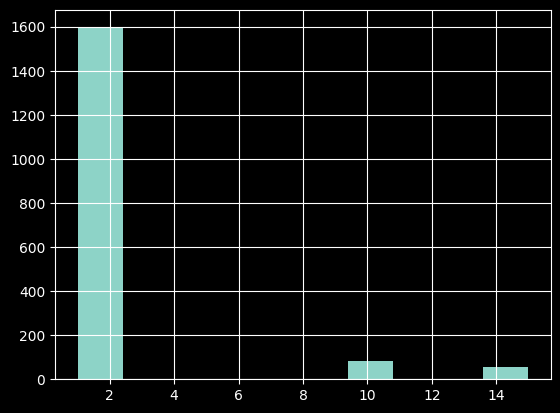

In [178]:
#@title Sample Weights

low = 70
turn_th = 1

gl_cols = list(map(gl_col_name, PERIOD_L_MINUTES))
gl_slope_cols = list(map(gl_slope_col_name, PERIOD_L_MINUTES))
last_glucose = gl_col_name((PERIOD_F-PERIOD_STEP) // timedelta(minutes=1))

def sample_weight(x):
  predict_low = x[gl_cols].min() < low and x[last_glucose] > low
  predict_turn = x[gl_slope_cols].min() < -turn_th and x[gl_slope_cols].max() > turn_th
  weight = 10 if predict_low else 1
  weight = weight * (1.5 if predict_turn else 1)
  return weight

g['sample_weights'] = g.apply(sample_weight, axis=1)
g.sample_weights.hist()

# data_table.DataTable(gg, max_columns=1000)

In [58]:
glucose.to_csv(os.path.join(CACHE_DIR, 'glucose.csv'))
g.to_csv(os.path.join(CACHE_DIR, 'glucose_fl.csv'))

In [181]:
split_idx = 8 * g.shape[0] // 10
LABEL_COLS = ['gl_slope', 'gl_slop2']
FEATURE_COLS = ['ia', 'ca', 'hr']

def filter_features(df):
  return df.reset_index().filter(
    ['hour'] + HR_LONG_COLS +
    [value_col_name(v, m) for v in LABEL_COLS for m in PERIOD_F_MINUTES] +
    [value_col_name(v, m) for v in FEATURE_COLS for m in PERIOD_MINUTES])

def split_features_and_labels(df):
  features = filter_features(df)
  labels = df.reset_index().filter([gl_slope_col_name(m) for m in PERIOD_L_MINUTES])
  return features, labels

train = g[:split_idx]
test = g[split_idx:]
train_features, train_labels = split_features_and_labels(train)
test_features, test_labels = split_features_and_labels(test)
test_gl_labels = test.reset_index().filter([gl_col_name(m) for m in PERIOD_L_MINUTES])

print('size full: %s train: %s test %s' % (g.shape, str(train_features.shape), str(test_features.shape)))

data_table.DataTable(train_features, max_columns=1000)

size full: (1739, 292) train: (1391, 219) test (348, 219)


,hour,hr_long,hr_lon2,gls_000,gls_005,gls_010,gls_015,gls_020,gls_025,gls_030,...,hr_190,hr_195,hr_200,hr_205,hr_210,hr_215,hr_220,hr_225,hr_230,hr_235
0,0,0.0,7.0,0.000000,-0.332776,-0.383612,-0.125418,0.000000,0.000000,0.000000,...,44.596670,45.596670,46.596670,47.000000,47.596670,48.000000,48.000000,46.806667,44.806667,43.403330
1,8,1.0,1.0,-1.300000,-1.009030,-0.509030,-0.474582,-0.716388,-0.741806,-0.700000,...,44.800000,45.800000,47.600000,48.000000,50.022472,51.176080,50.000000,50.000000,50.000000,50.000000
2,16,5.0,6.0,-0.825418,-0.641806,-0.600000,-0.483612,-0.167224,0.232776,0.632776,...,59.800000,59.600000,64.186040,65.204010,59.800000,61.800000,62.000000,60.600000,62.196014,60.006687
3,4,0.0,5.0,-0.081940,-0.900134,0.560230,3.243557,4.460172,3.032831,0.212375,...,66.400000,67.400000,72.980064,78.790000,77.613335,74.848880,69.930790,59.840000,56.075073,60.293232
4,8,0.0,5.0,2.761611,1.757861,0.034376,-0.723413,0.156522,0.409030,-0.147826,...,66.000000,71.600000,65.400000,61.000000,67.000000,66.200000,59.000000,54.400000,57.800000,54.200000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1386,4,0.0,4.0,-0.300000,-0.209365,-0.290635,-0.209364,0.071906,0.009364,-0.181271,...,55.005570,54.333332,56.666668,55.000000,58.333332,65.000000,68.000000,62.000000,50.000000,50.000000
1387,8,0.0,0.0,0.718855,0.156187,-0.171906,-0.109364,-0.371780,-0.490334,-0.227885,...,73.500000,73.000000,74.833336,74.000000,61.000000,66.833336,76.842100,75.411766,64.666664,56.666668
1388,12,0.0,0.0,2.577592,2.770902,2.258194,0.574582,-0.864214,-1.180602,-0.838796,...,59.404827,55.867050,55.000000,52.500000,53.333332,54.000000,55.000000,57.960000,62.760000,57.217392
1389,16,0.0,0.0,-0.389966,-0.310034,-0.210034,-0.110033,-0.010034,-0.089967,0.169901,...,56.833332,61.000000,69.847180,63.495678,60.000000,61.000000,60.833332,60.000000,60.000000,57.610000


# Create and Train the Tensorflow Model

In [251]:
class M(object):
  def __init__(self, name, **kwargs):
    self.name = name
    for k, v in kwargs.items():
      setattr(self, k, v)

  def init_model(self):
    normalizer = tf.keras.layers.Normalization() # axis=-1, mean=glucose_mean, variance=glucose_var)
    normalizer.adapt(train_features)
    self.model = tf.keras.Sequential([
    tf.keras.layers.InputLayer(input_shape=(train_features.shape[1],)),
    normalizer,
    tf.keras.layers.Dropout(rate=0.01),
    tf.keras.layers.Dense(units=300),
    # tf.keras.layers.Dropout(rate=0.01),
    tf.keras.layers.Dense(units=0),
    tf.keras.layers.Dense(units=train_labels.shape[1])])
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.002, beta_1=0.999),
    #optimizer=tf.keras.optimizers.SGD(learning_rate=1e-10, momentum=0.9),
    metrics=['mse', 'mae'],
    # loss_weights=loss_weights,
    weighted_metrics=['mse'],
    #loss=MyLoss())
    loss=tf.keras.losses.Huber(delta=0.5, name='huber_loss'))
    # loss=tf.keras.losses.MeanSquaredLogarithmicError()) #'mean_squared_error')
lr_schedule = tf.keras.callbacks.LearningRateScheduler(
    lambda epoch: 1e-10 * 10**(epoch / 20))

m = M('default')

In [236]:
class MyLoss(tf.keras.losses.Loss):
  def _call(y_true, y_pred):
    return tf.reduce_mean(
        tf.abs(1 if tf.greater(tf.matmul(y_true, y_pred), 0) else 2))
    #return 1 #abs(y_true[0] - y_pred[0])

  def call(self, y_true, y_pred, weight):
    # tf.function(MyLoss._call)
    return tf.reduce_mean(tf.abs(y_true - y_pred) * tf.where(y_true * y_pred >= 0, 1.0, 2.0))

# class AccuracyAt(tf.keras.metrics.Metric):
#   def __init__(self, time):
#     super(AccuracyAt, self).__init__(name='aat')
#     self.acc = self.add_weight(name='aAt', initializer='zeros')
#     self.time = time

#   def on_epoch_end(self, **kwargs):
#     print ("on_epoch_end " + str(kwargs))

#   def update_state(self, y_true, y_pred, sample_weight=None):
#     print("y_true %s" % str(y_true))
#     i = self.time // PERIOD_STEP
#     d = abs(y_true[i] - y_pred[i])
#     print("acc %s" % str(d[0]))
#     self.acc.assign_add(tf.reduce_sum(d))

#   def result(self):
#     return self.acc




  # def __call__(self, y_true, y_pred):
  #   i = self.time // PERIOD_STEP
  #   return abs(y_true[i] - y_pred[i])



In [173]:
def predict(model, features, add_glucose=False):
  pred_arrays = model.predict(filter_features(features)).transpose()
  prediction = pd.DataFrame(index=features.index)
  for i, m in enumerate(PERIOD_L_MINUTES):
    prediction[value_col_name('gl_slope', m)] = pred_arrays[i]

  if (add_glucose):
    last_glucose_col = gl_col_name(PERIOD_F_MINUTES[-1])
    prediction[last_glucose_col] = features[last_glucose_col]
    freq = 5
    for m in PERIOD_L_MINUTES:
      prediction[gl_col_name(m)] = (
          freq * prediction[gl_slope_col_name(m)] + prediction[gl_col_name(m - freq)])
  return prediction

def slope_to_glucose(pred):
  pg = pd.DataFrame()
  mm = PERIOD_F_MINUTES[-1]
  pg[gl_col_name(mm)] = test[gl_col_name(mm)]
  pg.reset_index(inplace=True)

  for m in PERIOD_L_MINUTES:
    pg[gl_col_name(m)] = 5 * pred[gl_slope_col_name(m)] + pg[gl_col_name(m - 5)]
  pg.pop('date')
  pg.pop(gl_col_name(mm))
  return pg

11/11 [==============================] - 0s 2ms/step


,gls_180,gls_185,gls_190,gls_195,gls_200,gls_205,gls_210,gls_215,gls_220,gls_225,...,gl_190,gl_195,gl_200,gl_205,gl_210,gl_215,gl_220,gl_225,gl_230,gl_235
date,,,,,,,,,,,,,,,,,,,,,
2022-10-22 00:00:00+00:00,-0.088768,0.047497,0.075710,0.248739,0.370575,0.178195,0.111809,-0.010046,0.061865,-0.103361,...,92.900386,94.144079,95.996953,96.887930,97.446974,97.396746,97.706070,97.189266,97.031977,97.070697
2022-10-22 04:00:00+00:00,3.038873,3.108141,2.642814,0.954325,0.258532,-1.270658,-0.860272,-1.641571,-1.381693,-1.441668,...,131.399142,136.170767,137.463429,131.110141,126.808783,118.600928,111.692461,104.484123,102.078707,104.153976
2022-10-22 08:00:00+00:00,0.815544,0.315096,0.322210,-0.179909,0.161137,-0.320671,-0.216873,-0.158103,-0.377032,0.020166,...,164.484984,163.585441,164.391124,162.787769,161.703404,160.912887,159.027727,159.128556,156.875013,154.426952
2022-10-22 12:00:00+00:00,-1.476415,-1.166500,-1.110102,-1.313120,-0.639579,-0.547323,-0.568805,-0.904958,-0.853658,-0.290324,...,125.254913,118.689315,115.491420,112.754806,109.910779,105.385991,101.117701,99.666079,99.836885,102.941687
2022-10-22 16:00:00+00:00,1.358264,1.477110,0.427302,0.201375,0.720865,-0.263514,-0.386282,-1.026760,-1.361107,-1.191611,...,229.972236,230.979111,234.583434,233.265862,231.334454,226.200652,219.395118,213.437062,212.100143,207.514141
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-12-30 20:00:00+00:00,-0.555268,-0.286715,-0.256379,-0.720257,-0.674640,-0.684224,-1.320193,-0.859622,-1.141021,-0.848705,...,103.508188,99.906900,96.533702,93.112583,86.511617,82.213508,76.508405,72.264879,68.705725,65.234043
2022-12-31 00:00:00+00:00,-0.014680,0.371523,0.232764,0.633357,0.328897,0.263763,0.416609,0.143577,-0.037865,-0.247567,...,77.386166,80.552952,82.197435,83.516251,85.599297,86.317183,86.127857,84.890021,86.088163,88.230920
2022-12-31 12:00:00+00:00,0.094736,-0.345205,-0.159745,0.346493,0.936102,0.155965,-0.748803,-0.454244,-0.502828,-0.253520,...,144.145008,145.877473,150.557983,151.337809,147.593796,145.322578,142.808439,141.540837,139.930558,138.062899


In [231]:
#@title Metrics Logging
tf_writer = None

def label_minutes_to_minutes(minutes):
  return minutes - (PERIOD_F - PERIOD_STEP) / timedelta(minutes=1)

def minutes_to_label(minutes):
  return minutes + (PERIOD_F - PERIOD_STEP) / timedelta(minutes=1)

def log_accuracy(epoch, logs):
  if epoch % 5 != 0: return
  p = predict(model, test, True)
  for minutes in (30, 60):
    col = gl_slope_col_name(minutes_to_label(minutes))
    err = (test[col] - p[col]).abs().mean()
    with tf_writer.as_default():
      tf.summary.scalar('slope accuracy %d min' % minutes, err, step=epoch)
    col = gl_col_name(minutes_to_label(minutes))
    gerr = (test[col] - p[col]).abs().mean()
    grerr = 100 * ((test[col] - p[col]) / test[col]).abs().mean()

    with tf_writer.as_default():
      tf.summary.scalar('glucose accuracy %d min' % minutes, gerr, step=epoch)
      tf.summary.scalar('glucose accuracy %% %d min' % minutes, grerr, step=epoch)
    # print('accuracy @%d min sl=%.3f glucose=%.1f' % (minutes, err, gerr))


In [237]:
%%time
log_base = os.path.join(CACHE_DIR, 'fitlogs')
log_dir = log_base + '/' + datetime.now().strftime("%Y%m%d-%H%M%S")
tf_writer = tf.summary.create_file_writer(log_dir)

history = model.fit(
    train_features,
    train_labels,
    epochs=200,
    batch_size=32,
    verbose=0,
    sample_weight=train.sample_weights.fillna(1.0).values,
    validation_split=0.2,
    callbacks=[
        tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1),
        keras.callbacks.LambdaCallback(on_epoch_end=log_accuracy)])
with tf_writer.as_default():
  tf.summary.flush()

11/11 [==============================] - 0s 3ms/step
CPU times: user 1min 34s, sys: 3.11 s, total: 1min 37s
Wall time: 2min 23s


In [225]:
# %tensorboard --logdir "$log_base"


dict_keys(['loss', 'mse', 'mae', 'weighted_mse', 'val_loss', 'val_mse', 'val_mae', 'val_weighted_mse'])

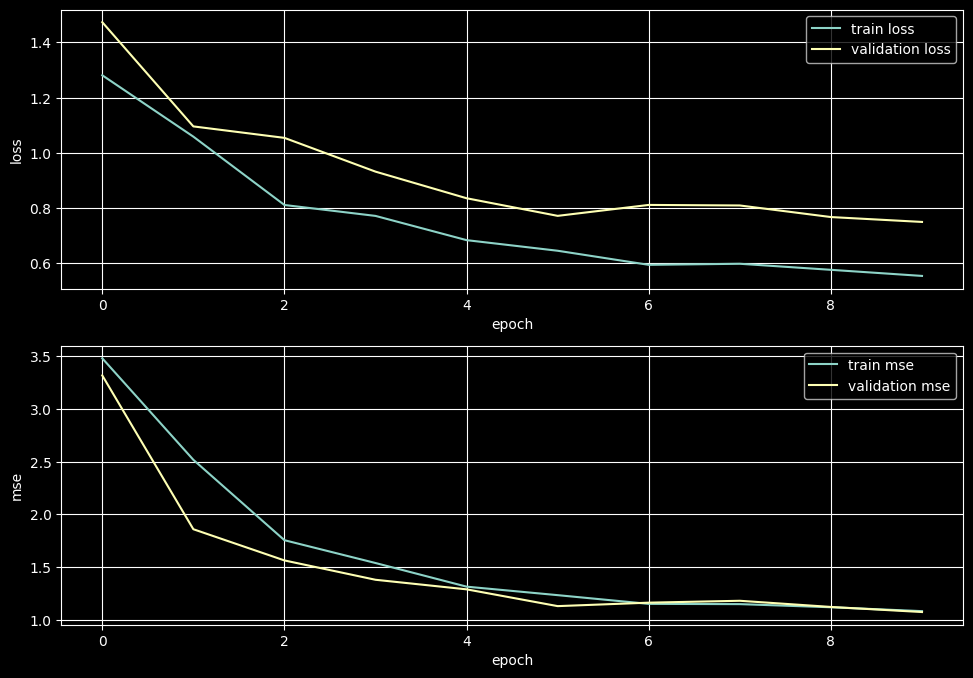

In [63]:
def plot_loss(history, metric, ax):
  ax.plot(history.history[metric], label='train ' + metric)
  ax.plot(history.history['val_' + metric], label='validation ' + metric)
  ax.set_xlabel('epoch')
  ax.set_ylabel(metric)
  ax.legend()
  ax.grid(True)

fig, axs = plt.subplots(nrows=2, subplot_kw={}, figsize=(10,7))
fig.tight_layout(pad=2.0)

plot_loss(history, 'loss', axs[0])
plot_loss(history, 'mse', axs[1])

In [64]:
r_glucose = glucose.copy()
r_glucose.fillna(0.0, inplace=True)
r_feature_columns = ['gl_slope', 'ca', 'ia', 'heart_rate']
r_label_columns = [gl_slope_col_name(m) for m in range(5, 65, 5)]
for m in range(5, 65, 5):
  r_glucose[gl_slope_col_name(m)] = r_glucose.gl_slope.asof(r_glucose.index + timedelta(minutes=m)).values

r_split_idx = 8 * r_glucose.shape[0] // 10
r_train = r_glucose[:r_split_idx]
r_test = r_glucose[r_split_idx:]

class RNNData:
  FEATURE_COLUMNS = ['gl_slope', 'ca', 'ia', 'heart_rate']
  LABEL_PERIODS = list(range(5, 65, 5))
  LABEL_COLUMNS = [gl_slope_col_name(m) for m in LABEL_PERIODS]

  def __init__(self, data, train_ratio=0.8):
    self.data = data.copy()
    self.data.fillna(0.0, inplace=True)
    for m in self.LABEL_PERIODS:
      self.data[gl_slope_col_name(m)] = self.data.gl_slope.asof(
          self.data.index + timedelta(minutes=m)).values

    split_idx = int(data.shape[0] * train_ratio)
    self.train_data = self.data[:split_idx]
    self.test_data = self.data[split_idx:]

  @property
  def train_features(self): return self.train_data.filter(self.FEATURE_COLUMNS, axis=1)
  @property
  def train_labels(self): return self.train_data.filter(self.LABEL_COLUMNS, axis=1)
  @property
  def test_features(self): return self.test_data.filter(self.FEATURE_COLUMNS, axis=1)
  @property
  def test_labels(self): return self.test_data.filter(self.LABEL_COLUMNS, axis=1)
  @property
  def test_gl_labels(self):
    l = pd.DataFrame(index=self.test_data.index)
    for m in self.LABEL_PERIODS:
      l[gl_col_name(m)] = self.data.glucose.asof(
          self.test_data.index + timedelta(minutes=m)).values
    return l

  @property
  def train_rows(self): return self.train_data.shape[0]

  @property
  def feature_cols(self): return len(self.FEATURE_COLUMNS)

  @property
  def label_cols(self): return len(self.LABEL_COLUMNS)

  def timeseries(self, features, labels=None, sequence_stride=12 * 5, batch_size=128):
    return tf.keras.utils.timeseries_dataset_from_array(
        data=features.fillna(0.0).values,
        targets=labels.fillna(0.0).values if labels is not None else None, #.reshape(rows, 1, len(r_label_columns))
        sequence_length=12 * 4,
        sequence_stride=sequence_stride, #self.label_cols,
        sampling_rate=1,
        batch_size=batch_size)

  def train_timeseries(self):
    return self.timeseries(self.train_features, self.train_labels)
  def test_timeseries(self):
    return self.timeseries(self.test_features, None)

rnn_data = RNNData(glucose)
# for r in rnn_data.test_timeseries(): print(r)
# data_table.DataTable(r_glucose[:1000], max_columns=1000)

CPU times: user 4.32 s, sys: 297 ms, total: 4.61 s
Wall time: 3.85 s


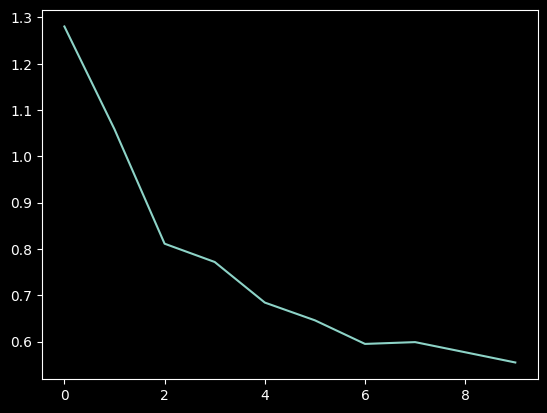

In [65]:
%%time
normalizer = tf.keras.layers.Normalization()
normalizer.adapt(rnn_data.train_features)

rnn_model = tf.keras.Sequential([
    tf.keras.layers.InputLayer(input_shape=(None, rnn_data.feature_cols)),
    normalizer,
    tf.keras.layers.LSTM(64, activation='relu'), #, recurrent_activation=None),
    tf.keras.layers.Dense(64),
    tf.keras.layers.Dense(rnn_data.label_cols)
])

rnn_model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.005, beta_1=0.9, beta_2=0.999),
    metrics=['accuracy'],
    loss='mse') #tf.keras.losses.Huber(delta=1.0, name='huber_loss'))

# history = rnn_model.fit(
#     rnn_data.train_timeseries(),
#     epochs=100,
#     verbose=1)

plt.plot(history.history['loss'], label='loss')

In [66]:
i = rnn_data.timeseries(rnn_data.train_features[:96], batch_size=1)
i = tf.keras.layers.InputLayer(input_shape=(None, rnn_data.feature_cols))(i)
# i = normalizer(i)
lstm = tf.keras.layers.LSTM(12, return_state=True, return_sequences=False, seed=3, activation=None)
lstm(list(i))
# list(i)

[<tf.Tensor: shape=(1, 12), dtype=float32, numpy=
 array([[-1.9067574e-18, -1.1203660e+00, -6.5289512e-09, -2.3099933e-11,
          1.2692678e-06, -1.7133619e+00,  3.4132076e-03, -1.7739246e+01,
          3.2444067e-08,  1.1250186e+02,  4.2859875e-03,  1.2348223e+01]],
       dtype=float32)>,
 <tf.Tensor: shape=(1, 12), dtype=float32, numpy=
 array([[-1.9067574e-18, -1.1203660e+00, -6.5289512e-09, -2.3099933e-11,
          1.2692678e-06, -1.7133619e+00,  3.4132076e-03, -1.7739246e+01,
          3.2444067e-08,  1.1250186e+02,  4.2859875e-03,  1.2348223e+01]],
       dtype=float32)>,
 <tf.Tensor: shape=(1, 12), dtype=float32, numpy=
 array([[-1.4876966e+00, -1.1279889e+00, -2.5947721e-04, -6.7985254e+02,
          8.3361435e+00, -1.7133619e+00,  1.0984506e+01, -1.7739256e+01,
          1.0715647e+00,  1.1250186e+02,  6.0112713e+01,  1.2348225e+01]],
       dtype=float32)>]

# Evaluate Model

In [128]:
#@title True and Predicted Slope Comparison

def truePred(col_name, true, pred, label_cols=PERIOD_L_MINUTES):
  result = pd.DataFrame(index=true.index)
  for m in label_cols:
    result['pred_%03d' % m] = pred[value_col_name(col_name, m)]
    result['true_%03d' % m] = true[value_col_name(col_name, m)]
  return result

prediction = predict(model, test_features)
data_table.DataTable(truePred('gl_slope', test_labels, prediction), max_columns=100)

11/11 [==============================] - 0s 2ms/step


,pred_180,true_180,pred_185,true_185,pred_190,true_190,pred_195,true_195,pred_200,true_200,...,pred_215,true_215,pred_220,true_220,pred_225,true_225,pred_230,true_230,pred_235,true_235
0,-0.036940,-0.283485,-0.360708,0.336790,-0.228494,0.399964,-0.252180,0.310702,0.011038,0.566702,...,0.236732,0.187626,0.330314,-0.435678,-0.297922,0.303679,0.274152,0.757191,0.024382,-0.450168
1,3.469220,2.883763,3.075548,2.462336,2.989472,1.416054,1.224244,1.391355,0.031964,1.937457,...,-1.513498,-1.639142,-0.909350,-1.533000,-0.721113,-1.052498,0.013813,-1.090833,-0.376911,-1.458528
2,0.821007,0.566890,0.753667,0.155183,-0.223380,-0.077927,-0.347234,0.166890,-0.530684,0.911707,...,-0.931011,-0.122073,-1.133465,0.521854,0.295290,0.688815,-0.556458,1.056743,-0.452394,0.121552
3,-2.078928,-1.420061,-1.012912,-1.136029,-1.552341,-0.570568,-1.792797,-0.145638,-0.579179,-0.277258,...,-1.353670,-0.877258,-1.435838,-0.811371,-0.151394,-0.534114,0.386859,-0.588629,0.540176,-0.688628
4,0.690042,1.075781,2.239995,0.745409,0.221556,0.878734,-1.085267,0.102419,-0.144949,-1.240802,...,-2.011123,-0.634114,-2.115407,-0.502133,-0.503063,0.118526,-0.680946,1.431564,-0.698193,1.779134
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
343,-0.963127,-0.442140,-1.251933,-0.828428,-0.472090,-0.871572,-0.025247,-0.771572,-0.121759,-0.643144,...,-0.081629,0.128428,-0.432699,0.001003,-0.093509,-0.471572,-0.121795,-0.229432,0.041751,0.058239
344,0.109019,-0.059531,-0.191340,0.496655,0.764013,1.000000,0.435656,0.831438,0.479015,0.259531,...,0.261737,0.084281,0.711168,0.271906,-0.593049,0.143813,0.171191,0.084281,-0.277517,0.300000
345,0.712319,0.007817,1.009583,0.193781,-0.144231,-0.154849,-1.242832,-0.327151,-0.089930,-0.590025,...,-0.597845,-0.590392,-0.391643,-0.191762,0.843246,-0.037124,0.735796,-0.399818,-0.527687,-0.345151
346,1.874358,1.813297,1.895024,2.265452,1.574811,1.469980,1.249373,0.110368,0.080836,-0.318729,...,0.512047,0.547826,-0.054359,-0.481271,0.596490,-0.456187,0.039163,0.335452,0.064572,0.618729


In [129]:
# rnn_model.predict(rnn_data.timeseries(rnn_data.test_features[:240]))

# def r_predict(features):
#   p = rnn_model.predict(rnn_data.timeseries(features, batch_size=1, sequence_stride=1))
#   prediction = pd.DataFrame(index=features.index)
#   p = p.transpose()
#   for i, c in enumerate(rnn_data.LABEL_COLUMNS):
#     missing = (prediction.shape[0]-p[i].size)
#     values = np.insert(p[i], 0, missing*[0])
#     prediction[c] = values

#   return prediction

# r_prediction = r_predict(rnn_data.test_features)
# data_table.DataTable(
#     truePred('gl_slope', rnn_data.test_labels, r_prediction, rnn_data.LABEL_PERIODS)[100:5000],
#     max_columns=100)


In [130]:
#@title True and Predicted Value Comparison
pg = slope_to_glucose(prediction)
data_table.DataTable(truePred('glucose', test_gl_labels, pg), max_columns=100)

,pred_180,true_180,pred_185,true_185,pred_190,true_190,pred_195,true_195,pred_200,true_200,...,pred_215,true_215,pred_220,true_220,pred_225,true_225,pred_230,true_230,pred_235,true_235
0,92.543488,89.311035,90.739949,89.89333,89.597477,92.678930,88.336579,93.892975,88.391767,95.785950,...,90.423566,108.677850,92.075137,107.214050,90.585526,104.321070,91.956284,110.250840,92.078196,111.892975
1,104.796098,100.496640,120.173839,116.28763,135.121200,125.120000,141.242418,130.448170,141.402238,139.033550,...,119.096450,148.990000,114.549701,139.966450,110.944136,133.660000,111.013200,129.441470,109.128646,122.751680
2,161.325767,161.448170,165.094103,162.88963,163.977204,163.000000,162.241033,162.110370,159.587613,164.668900,...,151.076355,169.441470,145.409029,171.668900,146.885477,174.660000,144.103185,178.557050,141.841216,185.227430
3,133.625359,136.816670,128.560798,129.81940,120.799096,125.456375,111.835111,124.113716,108.939217,124.000000,...,97.960890,114.454850,90.781699,109.568565,90.024730,106.341140,91.959025,104.227425,94.659904,100.454850
4,217.109069,219.317720,228.309044,224.41667,229.416824,226.771800,223.990489,233.204010,223.265746,227.795990,...,204.711527,211.568560,194.134493,210.113710,191.619176,206.547230,188.214447,211.298970,184.723483,220.862870
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
343,104.184365,108.147156,97.924699,104.57860,95.564248,99.862880,95.438013,95.862880,94.829220,92.147156,...,86.195532,87.568565,84.032035,89.000000,83.564488,87.578600,82.955514,84.284280,83.164270,85.284280
344,74.983223,73.000000,74.026521,73.84281,77.846584,77.966550,80.024861,83.842810,82.419935,86.280940,...,85.956926,85.000000,89.512764,85.842810,86.547517,87.719060,87.403471,87.280940,86.015885,88.561874
345,149.757673,144.513700,154.805587,146.27425,154.084434,146.451500,147.870272,144.725750,147.420621,143.180000,...,143.057329,130.369130,141.099111,126.822750,145.315340,128.451500,148.994318,126.451510,146.355885,124.453330
346,93.997210,91.700000,103.472331,102.75839,111.346384,114.354515,117.593251,117.458190,117.997432,115.458190,...,123.709944,122.541810,123.438149,122.374580,126.420598,117.729095,126.616413,117.812706,126.939275,121.083610


In [131]:
# def r_slope_to_glucose(features, predict):
#   r_glucose = features.filter(['glucose'], axis=1)
#   g = 'glucose'
#   for c in rnn_data.LABEL_PERIODS:
#     r_glucose[gl_col_name(c)] = 5 * predict[gl_slope_col_name(c)] + r_glucose[g]
#     g = gl_col_name(c)
#   return r_glucose

# r_pg = r_slope_to_glucose(rnn_data.test_data, r_prediction)
# data_table.DataTable(truePred('glucose', rnn_data.test_gl_labels, r_pg, rnn_data.LABEL_PERIODS)[100:1000], max_columns=100)
# data_table.DataTable(r_pg[:1000])

mean absolute error: 0.7
mean absolute error perc: 84.0


,e 10%-ile,e 50%-ile,e 75%-ile,e 90%-ile,e 99%-ile,e% 10%-ile,e% 50%-ile,e% 75%-ile,e% 90%-ile,e% 99%-ile,mean_abs_error,mean_abs_error_p
gls_180,0.063521,0.313578,0.580650,0.866875,1.624856,9.725180,42.785101,74.747928,122.008539,189.452766,0.414302,54.579948
gls_185,0.080028,0.441657,0.734504,1.112311,1.816900,12.425056,56.319759,94.843457,136.135246,186.156553,0.534829,65.750913
gls_190,0.089581,0.506312,1.020546,1.419242,2.510196,14.561042,68.176449,108.897197,159.498790,187.720621,0.680898,76.629518
gls_195,0.111944,0.637511,1.160008,1.692309,3.228154,19.627587,81.545473,117.072705,164.109597,191.398432,0.815580,84.728366
gls_200,0.125227,0.605465,1.091973,1.606418,3.019588,28.798995,87.241416,123.539418,154.152589,197.149263,0.787398,90.733528
gls_205,0.107843,0.653092,1.220337,1.878640,3.327404,21.063173,82.611452,124.871964,159.867934,192.885041,0.858246,86.810286
gls_210,0.107638,0.567281,1.132218,1.639104,2.911001,25.176277,85.437371,125.799615,159.162073,193.285793,0.764077,89.260842
gls_215,0.103422,0.511099,0.970644,1.556949,3.426670,20.908564,81.322912,120.603264,163.776904,197.956473,0.730244,86.771053
gls_220,0.137504,0.587316,1.108051,1.923694,3.344617,24.577104,86.356466,131.439222,163.778391,195.960954,0.820732,89.791419
gls_225,0.140789,0.629755,1.106291,1.645856,3.095949,29.976457,93.988541,130.679872,163.013525,195.296132,0.803327,95.015293


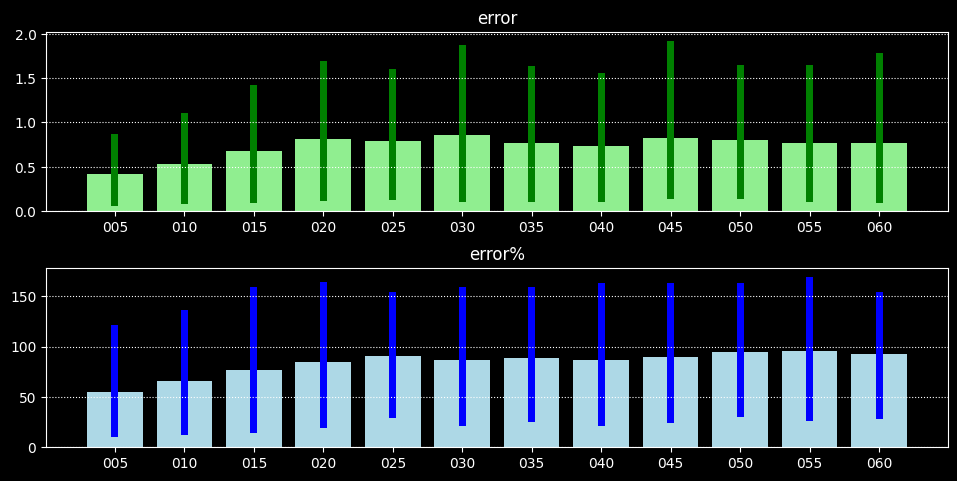

In [132]:
#@title Mean Error and Error Quantiles

def print_errors(true, pred):
  abs_error = (pred - true).abs()
  mean_abs_error = abs_error.sum().sum() / pred.size
  mean_abs_errors = abs_error.sum() / pred.shape[0]

  maxv = pred.abs().where(pred.abs() > true.abs(), true.abs())
  abs_error_p = (100*(pred - true)/maxv).abs()
  mean_abs_errors_p = abs_error_p.sum() / pred.shape[0]

  print("mean absolute error: %.01f" % mean_abs_error)
  print("mean absolute error perc: %.01f" % mean_abs_errors_p.mean())

  bar_labels = ['%03d' % m for m in range(5, 65, 5)]
  fig, axs = plt.subplots(nrows=2, subplot_kw={}, figsize=(10,5))
  fig.tight_layout(pad=2.0)

  ax = axs[0]
  ax.set_title("error")
  ax.bar(bar_labels, mean_abs_errors.values, color='lightgreen')
  ax.bar(bar_labels,
        (abs_error.quantile(q=0.9)-abs_error.quantile(q=0.1)).values,
        bottom=abs_error.quantile(q=0.1).values, width=0.1, color='green')
  ax.grid(True, which='major', axis='y', ls=':')
  ax = axs[1]
  ax.set_title("error%")
  ax.bar(bar_labels, mean_abs_errors_p.values, color='lightblue')
  ax.bar(bar_labels,
        (abs_error_p.quantile(q=0.9)-abs_error_p.quantile(q=0.1)).values,
        bottom=abs_error_p.quantile(q=0.1).values, width=0.1, color='blue')
  ax.grid(True, which='major', axis='y', ls=':')

  cols = {'%s %.0f%%-ile' % (n, 100 * q): ae.quantile(q=q) for n, ae in [('e', abs_error), ('e%', abs_error_p)] for q in [0.1, 0.5, 0.75, 0.9, 0.99]}
  cols['mean_abs_error'] = mean_abs_errors
  cols['mean_abs_error_p'] = mean_abs_errors_p
  return pd.DataFrame(cols)


error = print_errors(test_labels, prediction)
# error = print_errors(rnn_data.test_labels, r_prediction)
data_table.DataTable(error)


mean absolute error: 14.1
mean absolute error perc: 10.7


,e 10%-ile,e 50%-ile,e 75%-ile,e 90%-ile,e 99%-ile,e% 10%-ile,e% 50%-ile,e% 75%-ile,e% 90%-ile,e% 99%-ile,mean_abs_error,mean_abs_error_p
gl_180,0.271885,1.839525,3.232435,4.809278,11.129751,0.221755,1.515103,2.592364,4.130501,8.978719,2.343094,1.989059
gl_185,0.497246,3.180227,5.351009,8.257439,15.413537,0.442858,2.548465,4.478334,6.897391,12.376004,3.931375,3.256995
gl_190,0.673747,4.034242,8.441059,12.914329,19.599188,0.579116,3.407721,6.664455,9.513889,20.321636,5.691585,4.642199
gl_195,1.091385,5.652955,11.633344,17.182316,29.195182,0.879582,4.731369,9.026875,13.570058,24.206678,7.899901,6.358917
gl_200,1.230936,7.929475,15.078829,22.928148,37.473371,1.154886,6.464678,12.351701,17.491159,28.378048,10.363744,8.238609
gl_205,1.446079,9.821348,18.601540,27.327750,51.256671,1.312737,8.693011,15.517357,21.651768,34.764639,13.170944,10.272866
gl_210,1.531481,12.430351,22.637719,32.766229,65.581387,1.341613,10.542930,17.258863,25.242576,38.039970,15.568421,11.983883
gl_215,2.729460,13.600410,24.171340,40.551331,73.836738,2.311347,11.337550,19.072211,29.865573,42.678154,17.818037,13.573778
gl_220,2.661113,16.002337,26.898556,46.110911,74.622117,2.380526,13.630630,21.289721,33.466828,47.139881,20.480505,15.470482
gl_225,2.955250,17.333489,29.343300,49.172901,79.792040,2.910432,14.742439,23.454141,35.745804,49.882520,22.313335,16.663673


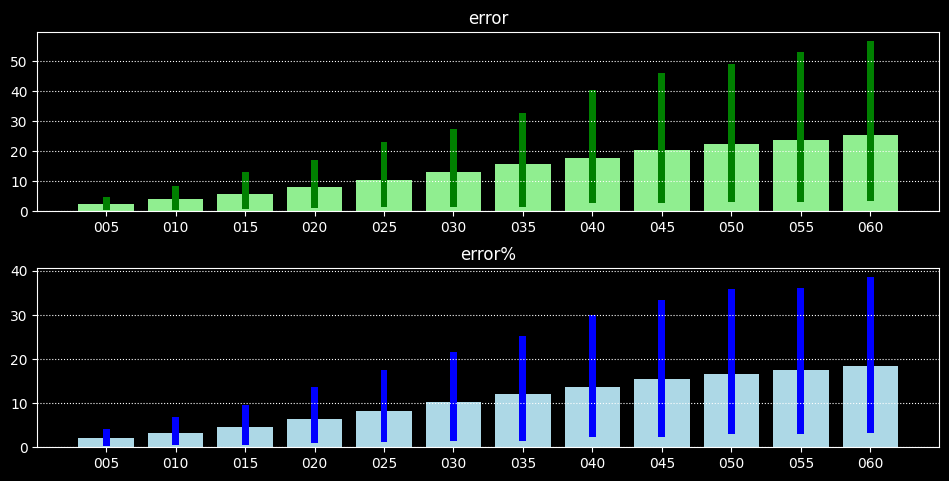

In [133]:
#@title Glucose Errors
error = print_errors(test_gl_labels, pg)
data_table.DataTable(error)

In [153]:
# gg = gl_p.copy()
# gg.dropna(inplace=True)
# gg['dev_class'] = np.sign(gg.glucose - gg.glucose_pred)

# (gg.glucose - gg.glucose_pred).hist()

# (pg['gl_145'] - test_gl_labels['gl_145']).hist()

col='gl_205'
gg = pd.DataFrame(index=pg.index) #pg.join(test_gl_labels, lsuffix='_p')
gg['t'] = test_gl_labels[col]
gg['p'] = pg[col]

print("Correct lows: %.0f" % gg[(gg.p < 70) & (gg.t < 70)].shape[0])
print("False lows: %.0f" % gg[(gg.p < 70) & (gg.t > 70)& abs((gg.p-gg.t) > 10)].shape[0])
print("Missed lows: %.0f" % gg[(gg.p > 70) & (gg.t < 70) & abs((gg.p-gg.t) > 10)].shape[0])
print("False highs: %.0f" % gg[(gg.p < 150) & (gg.t > 150)& abs((gg.p-gg.t) > 10)].shape[0])
print("Correct highs: %.0f" % gg[(gg.p > 150) & (gg.t > 150)].shape[0])
print("Missed highs: %.0f" % gg[(gg.p > 150) & (gg.t > 150) & abs((gg.p-gg.t) > 10)].shape[0])


Correct lows: 9
False lows: 0
Missed lows: 1
False highs: 0
Correct highs: 37
Missed highs: 3


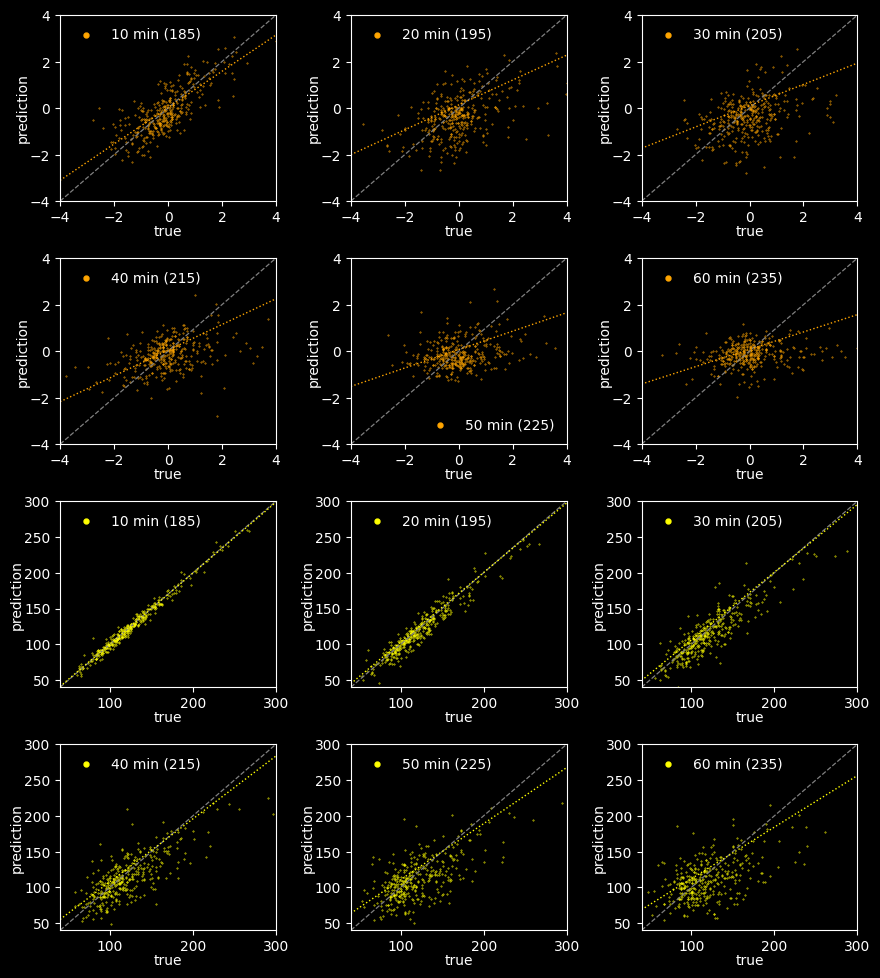

In [135]:
# @title True vs. Predicted Value Plots

fig, axs = plt.subplots(nrows=4, ncols=3, subplot_kw={}, figsize=(9,10))
fig.tight_layout(pad=2.0)

def plot_linear_regression(ax, x_series, y_series, color, range):
  length = x_series.shape[0]
  p = np.polyfit(x_series.values, y_series.values, deg=1)
  x_ext = np.linspace(range[0], range[1], length)
  y_ext = np.poly1d(p)(x_ext)
  ax.plot(x_ext, y_ext, color=color, linewidth=1, linestyle='dotted')

def scatter(ax, name, true, pred, color, range, minutes):
  m = minutes - (-PERIOD_STEP + PERIOD_F) / timedelta(minutes=1)
  ax.scatter(pred[name], true[name], s=0.5, marker='.', color=color, label='%d min (%d)' % (m, minutes))
  ax.set_xlabel('true', labelpad=0)
  ax.set_ylabel('prediction', labelpad=0)
  ax.set_xlim(range[0], range[1])
  ax.set_ylim(range[0], range[1])
  ax.set_xmargin(20)
  ax.set_label([name])
  ax.legend(markerscale=10, frameon=False)
  ax.plot([0, 1], [0, 1], transform=ax.transAxes, color='grey', linestyle='--', linewidth=0.9)
  plot_linear_regression(ax, true[name], pred[name], color, range)

for i, m in enumerate([m for m in PERIOD_L_MINUTES[1::2]]):
  scatter(axs[i//3][i%3], gl_slope_col_name(m), prediction, test_labels, color='orange', range=(-4, 4), minutes=m)
for i, m in enumerate(PERIOD_L_MINUTES[1::2]):
  scatter(axs[2 + i//3][i%3], gl_col_name(m), pg, test_gl_labels, color='yellow', range=(40, 300), minutes=m)

plt.show()

In [136]:
#@title Unpivot Predictions and Join with Original Data
def unpivot(df, date_series):
  df_date = df.copy()
  df_date['date'] = date_series.dt.to_pydatetime()
  df_l = pd.wide_to_long(df_date, stubnames='gl_', i='date', j='minute')
  df_l.reset_index(inplace=True)
  df_l['date'] = df_l.apply(lambda r: r.date + timedelta(minutes=r.minute), axis=1)
  df_l.pop('minute')
  df_l.rename({'gl_': 'glucose'}, inplace=True, axis=1)
  df_l.sort_values(by='date', inplace=True)
  df_l.set_index('date', inplace=True)
  return df_l

prediction_l = unpivot(pg, g.reset_index()[split_idx:]['date'])

# prediction_l[:100]
glucose['date5'] = glucose.index.map(lambda dt: dt.floor('H') + timedelta(minutes=5 * (dt.minute // 5)))
gl_p = glucose.set_index('date5').join(prediction_l, how='outer', rsuffix='_pred', sort=True)
data_table.DataTable(gl_p[-100:])

,hour,glucose,gl_slope,gl_slop2,heart_rate,hr_long,hr_lon2,carbs,ca,bolus,basal,ia,glucose_pred
2022-12-31 15:40:00+00:00,16,126.82275,-0.191762,0.055327,77.663890,19.0,19.0,0.0,0.0,0.0,0.049350,2.305716,141.099111
2022-12-31 15:45:00+00:00,16,128.45150,-0.037124,-0.020806,77.502780,19.0,19.0,0.0,0.0,0.0,0.121683,2.402081,145.315340
2022-12-31 15:50:00+00:00,16,126.45151,-0.399818,-0.030803,77.991670,19.0,19.0,0.0,0.0,0.0,-0.020000,2.431344,148.994318
2022-12-31 15:55:00+00:00,16,124.45333,-0.345151,0.036285,81.807800,19.0,19.0,0.0,0.0,0.0,-0.020000,2.408493,146.355885
2022-12-31 16:00:00+00:00,17,123.00000,-0.036972,0.082642,91.000000,19.0,19.0,0.0,0.0,0.0,0.079059,2.349593,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-12-31 23:35:00+00:00,0,111.46488,-0.426756,-0.000702,62.166668,14.0,19.0,0.0,0.0,0.0,0.000000,3.802702,106.238213
2022-12-31 23:40:00+00:00,0,109.19733,-0.553512,-0.038027,60.666668,14.0,19.0,0.0,0.0,0.0,0.000000,3.477453,101.143833
2022-12-31 23:45:00+00:00,0,105.92976,-0.807024,-0.051973,59.000000,14.0,19.0,0.0,0.0,0.0,0.000000,3.163022,101.147903
2022-12-31 23:50:00+00:00,0,101.12709,-1.073244,0.080702,58.333332,14.0,19.0,0.0,0.0,0.0,0.053333,2.864660,101.086329


In [137]:
#@title Timeline Date

start_date = '2022-10-29' # @param{type: 'date'}
days = 3 # @param{type:'slider', min: 0, max: 30}
tt = timedelta(days=days)
start = pd.to_datetime(start_date)

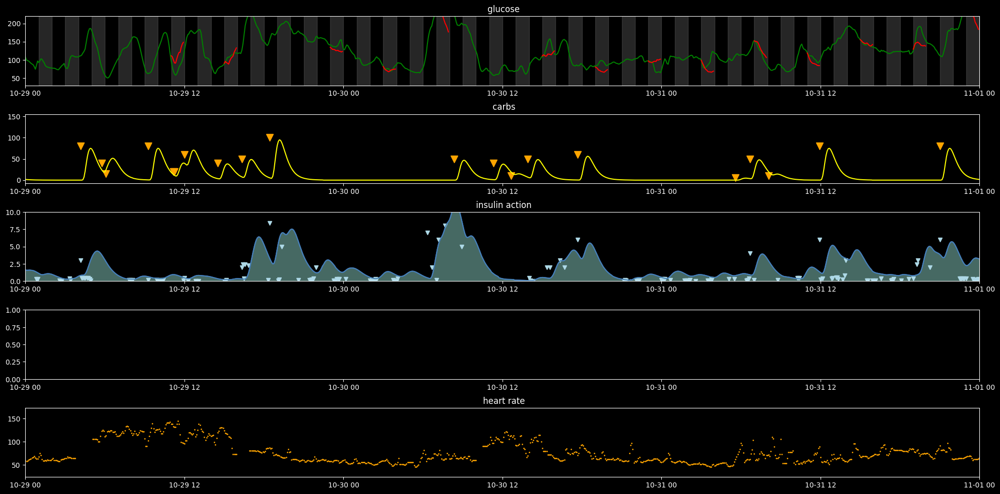

In [138]:
#@title Prediction Timeline

date_range = start, start + tt
fig, axs = plt.subplots(nrows=5, subplot_kw={}, figsize=(20,10))
fig.tight_layout(pad=2.0)

def plot_result(axs, gl, carbs, insulin, hr, title=None, date_range=None, glucose_range=(30, 220)):
  axs[0].set_ylim(glucose_range[0], glucose_range[1])
  axs[2].set_ylim(0, 10)
  date_range = date_range or (gl.index.min(), gl.index.max())
  for ax in axs: ax.set_xlim(date_range)
  axs[0].plot_date(gl.index, gl['glucose'], linestyle='-', markersize=0, color='green')
  axs[0].plot_date(gl.index, gl['glucose_pred'], linestyle='-', markersize=0, color='red')
  for dt in pd.date_range(start=date_range[0], end=date_range[1], freq=timedelta(hours=2)):
    s = mdates.date2num(dt + timedelta(hours=1))
    e = mdates.date2num(dt + timedelta(hours=2))
    r = Rectangle((s, glucose_range[0]), e-s, glucose_range[1], color='grey', alpha=0.3)
    axs[0].add_patch(r)
  axs[1].plot_date(gl.index, gl['ca'], linestyle='-', markersize=0, color='yellow')
  axs[1].plot_date(carbs['date'], carbs['carbs'], fmt='v', markersize=10, color='orange', zorder=1)
  axs[2].plot_date(gl.index, gl['ia'], linestyle='-', markersize=0, color='royalblue')
  axs[2].plot_date(
      insulin['date'], insulin['bolus'],
      fmt='v', color='lightblue')
  axs[0].set_title("%s glucose" % (title or ''))
  axs[1].set_title("%s carbs" % (title or ''))
  axs[2].set_title("%s insulin action" % (title or ''))
  if hr is not None:
    axs[-1].plot_date(
        hr.index, hr['heart_rate'], linestyle='',
        markersize=1, color='orange')
    axs[-1].set_title("%s heart rate" % (title or ''))

def plot_basal(ax, x, y, color=None):
  ax.plot_date(
      x='x', y='y', color=color, data={'x':x,'y':y},
      drawstyle='steps-post', linestyle='-', markersize=0)
  ax.fill_between(x=x, y1=y, color=color, alpha=0.5, step='post')

plot_result(
    axs, gl_p, glucose[glucose.carbs > 0].reset_index(),
    glucose[glucose.bolus > 0].reset_index(), glucose,
    date_range=date_range)
axs[2].plot_date(
    gl_p.index,
    gl_p['ia'],
    linestyle='-',
    markersize=0, color='steelblue')
axs[2].fill_between(gl_p.index, gl_p.ia, alpha=0.5)

# basal_rates_data = DateTimeInsulin.to_data(basal_rates)
# axs[3].set_title('basal')
# plot_basal(
#     axs[3], color='lightblue',
#     x=basal_rates_data['dates'], y=basal_rates_data['values'])
# basal_rates_data = DateTimeInsulin.to_data(basal_rates_adj)
# plot_basal(
#     axs[3], color='purple',
#     x=basal_rates_data['dates'], y=basal_rates_data['values'])
# axs[3].set_ylim(0, 5)
plt.show()

# del basal_rates_data

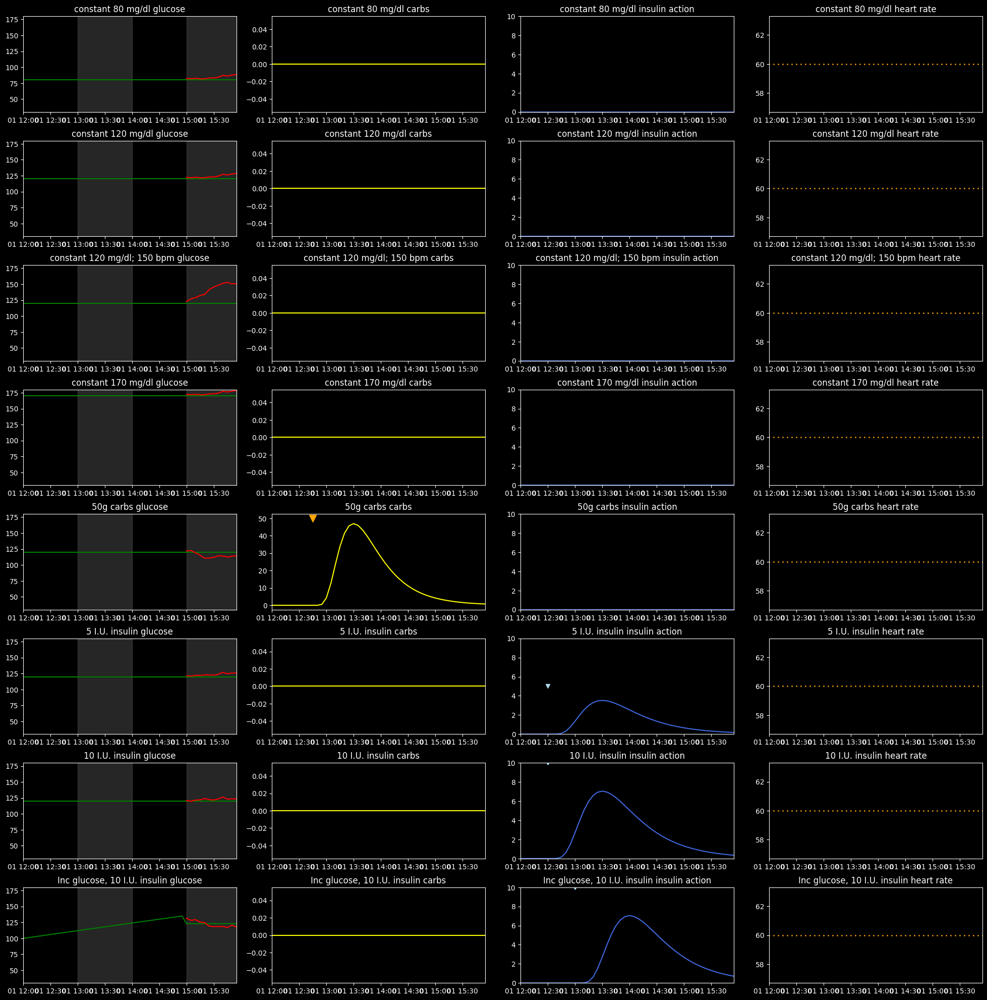

In [139]:
#@title Standard Scenarios
row_count = len(PERIOD_MINUTES)
glucose_range=(30, 180)

def plot_result3(ax, gic, title):
  plot_result(ax, gic[0], gic[1], gic[2], gic[3], glucose_range=glucose_range, title=title)

test_data = []
def add_prediction(df):
  global test_data
  df1 = df.copy()
  df1.set_index('date', inplace=True)
  f, l = split_features_and_labels(pivot_for_model(df1))
  gl = df['glucose'][len(PERIOD_F_MINUTES)-1]
  gls = []
  gl_slopes = model(f, training=False).numpy()[0].tolist()
  for gl_slope in gl_slopes:
    gls.append(gl + 5 * gl_slope)
    gl = gls[-1]

  df['glucose_pred'] = len(PERIOD_F_MINUTES) * [math.nan] + gls
  test_data[-1]['inputVector'] = f.values[0].tolist()
  test_data[-1]['outputSlopes'] = gl_slopes
  test_data[-1]['outputGlucose'] = gls

def create_static_data(glucose, carb_events, insulin_events, hr=60, hr_long=0):
  global test_data
  df = pd.DataFrame({
      'date': pd.date_range('2023-11-01T12:00Z', periods=row_count, freq=timedelta(minutes=5)),
      'glucose': glucose})
  d, v = zip(*carb_events) if carb_events else ([], [])
  carbs = pd.DataFrame({ 'date': d, 'carbs': v})
  d, v = zip(*insulin_events) if insulin_events else ([], [])
  insulin = pd.DataFrame({ 'date': d, 'bolus': v})
  df['gl_slope'] = slope_series(df['glucose'], df['date'], timedelta(minutes=1)).fillna(0.0)
  df['gl_slop2'] = slope_series(df['gl_slope'], df['date'], timedelta(minutes=1)).fillna(0.0)
  df['ia'] = np.array(INSULIN_ACTION.values_at(insulin['date'].values, insulin['bolus'].values, df['date'].values))
  df['ca'] = np.array(CARB_ACTION.values_at(carbs['date'].values, carbs['carbs'].values, df['date'].values))
  df['heart_rate'] = np.array(row_count * [hr])
  df['hr_long'] = np.array(row_count * [hr_long])
  df['hr_lon2'] = np.array(row_count * [hr_long])
  df['minute'] = ((df['date'] - df['date'][0]) / timedelta(minutes=1)).astype(int)
  test_data.append({'at': str(df['date'][0])})
  test_data[-1]['inputData'] = df.drop(['date'], axis=1).to_dict(orient='list')
  test_data[-1]['insulinEvents'] = list(
      map(lambda dv: {'timestamp': str(dv[0]), 'value': dv[1] }, insulin_events))
  test_data[-1]['carbEvents'] = list(
      map(lambda dv: {'timestamp': str(dv[0]), 'value': dv[1] }, carb_events))
  test_data[-1]['heartRates'] = row_count * [hr]
  test_data[-1]['hrLongCounts'] = 2 * [hr_long]

  add_prediction(df)
  df.set_index('date', inplace=True)
  global xdf
  xdf = df
  return df, carbs, insulin, df

gics = [
    (create_static_data(row_count * [80], [], []), 'constant 80 mg/dl'),
    (create_static_data(row_count * [120], [], []), 'constant 120 mg/dl'),
    (create_static_data(row_count * [120], [], [], hr_long=100), 'constant 120 mg/dl; 150 bpm'),
    (create_static_data(row_count * [170], [], []), 'constant 170 mg/dl'),
    (create_static_data(row_count * [120], [(pd.to_datetime('2023-11-01T12:45Z'), 50)], []), '50g carbs'),
    (create_static_data(row_count * [120], [], [(pd.to_datetime('2023-11-01T12:30Z'), 5)]), '5 I.U. insulin'),
    (create_static_data(row_count * [120], [], [(pd.to_datetime('2023-11-01T12:30Z'), 10)]), '10 I.U. insulin'),
    (create_static_data(
        list(list(range(100, 100 + 36)) + (12 * [123])),
         [],
         [(pd.to_datetime('2023-11-01T13:00Z'), 10)]), 'Inc glucose, 10 I.U. insulin'),
]

for i in range(0, len(gics)):
  test_data[i]['name'] = gics[i][1]

fig, axs = plt.subplots(nrows=len(gics), ncols=4, subplot_kw={}, figsize=(20, 2.5 * len(gics)))
fig.tight_layout(pad=2.0)

for ax, gic in zip(axs, gics): plot_result3(ax, gic[0], gic[1])
plt.show()

#Output Model

In [140]:
converter = tf.lite.TFLiteConverter.from_keras_model(model)
converter.inference_input_type = tf.float32
tflite_model_bytes = converter.convert()
tflite_model = tf.lite.Interpreter(model_content=tflite_model_bytes)
tflite_model_path = os.path.join(CACHE_DIR, 'glucose_model.tflite')
with open(tflite_model_path, 'wb') as f:
    f.write(tflite_model_bytes)

meta = {
    'tensorflow_version': tf.__version__,
    'trainingPeriodMinutes': PERIOD_F.seconds // 60,
    'predictionPeriodMinutes': PERIOD_L.seconds // 60,
    'carbAction': {'mu': CARB_ACTION.mu, 'sigma': INSULIN_ACTION.sigma },
    'insulinAction': {'mu': INSULIN_ACTION.mu, 'sigma': INSULIN_ACTION.sigma },
    'hrHighThreshold': HR_HIGH_THRESHOLD,
    'hrLongDurationMinutes': HR_LONG_MINUTES,
    'testData': test_data,
    'freqMinutes': 5,
}

with open(os.path.join(CACHE_DIR, 'glucose_model.json'), 'w') as f:
  json.dump(meta, f)


model.save(os.path.join(CACHE_DIR, 'glucose_model.keras'))
tf.saved_model.save(model, os.path.join(CACHE_DIR, 'm'))

model_dir = os.path.join(CACHE_DIR, 'glucose_model')
if not os.path.exists(model_dir): os.mkdir(model_dir)
model.save(os.path.join(model_dir, 'weights.h5'), save_format='h5')

model_json = model.to_json()
with open(os.path.join(model_dir, 'model.json'), 'w') as json_file:
    json_file.write(model_json)

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [141]:
# print(tflite_model.get_input_details())
# tflite_model.allocate_tensors()
# # input = list(map(lambda f: np.float32(f), ff.values[0].tolist()))
# print(input)
# # input = [[np.float32(0)] + 158 * [np.float32(0.0)]]
# tflite_model.set_tensor(0, np.expand_dims(input, axis=0))
# # tflite_model.set_tensor(0, np.expand_dims([np.float32(0)] + 158 * [np.float32(0.0)], axis=0))
# tflite_model.invoke()
# output_index = tflite_model.get_output_details()[0]['index']
# print('Result: ' + 'F, '.join(map(lambda f: '%0.4f' % f, tflite_model.get_tensor(output_index)[0].tolist())) + 'F')


array([nan, nan, nan, nan, nan, nan, nan, nan, nan, nan])

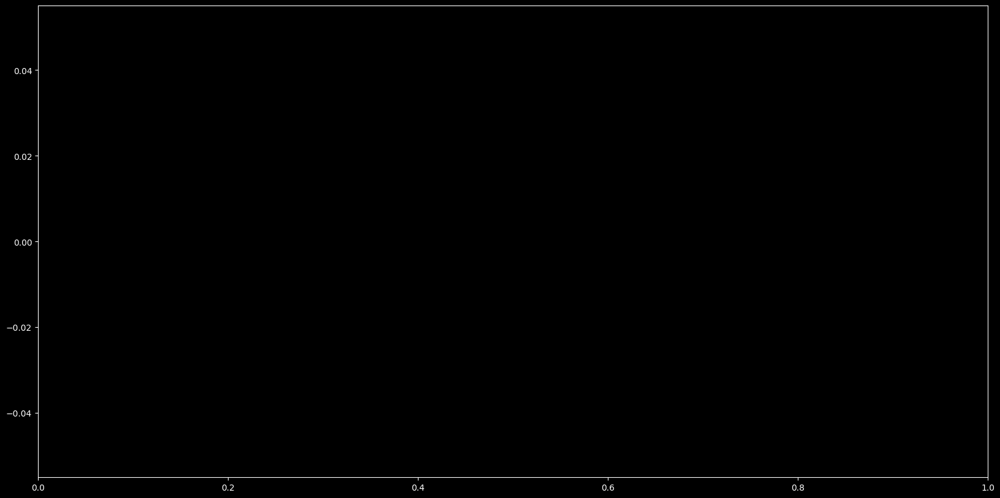

In [142]:
gl = glucose['glucose'].values[:10000] / 300.

t = np.arange(256)
f = np.fft.fft(gl)
f = np.abs(f) ** 2
freq = np.fft.fftfreq(gl.shape[-1], d=1/12)
fig, axs = plt.subplots(nrows=1, ncols=1, subplot_kw={}, figsize=(20,10))
ax = axs
ax.set_xlim(0, 1)
# ax.set_ylim(0, 100)
ax.plot(freq, 10 * np.log10(f.real))

f[:10]
# gl[:100]

# fourier = np.fft.fft(gl)

# fourier[1]
# ax.plot(fourier[10:])